<a href="https://colab.research.google.com/github/146790g/BreakHis-VGG16/blob/master/BreakHis_VGG16_3_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 深層学習 VGG16モデルのファイン・チューニング法を用いた乳がん染色画像の解析

#（その３ : Visual Predictive Check ）


##  Deep Learning for Magnification Independent Breast Cancer Histopathology
## Image Classification

４つのMagnification levelのデータをすべて合算して、解析する

<br>

## 4 Magnification Levels: ×40, ×100, ×200, ×400


During analysis and annotation, pathologists starts by identifying ROIs in
the lowest magnification level slide (×40), then dives deeper in the latter using higher magnification levels (×100, ×200) until having a profound insight
(×400). 

<br>



## データ数 の概要

### Training Data: 5026 images <br>
###  -- Benign Data: 1472 images <br>
###  -- Mallignant Data: 3554 images 

### Validation Data: 2904 images <br>
### -- Benign Data: 1008 images <br>
### -- Mallignant Data:1896 images <br>

## Data Set Details by Magnification levels.

 ×40 : <br>
×100 : <br>
×200 : <br>
×400 : <br>


<iframe width="560" height="315" src="https://www.youtube.com/embed/oDHpqu52soI" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>



##  VGG16モデル解析についてのyoutube動画の説明

[Fine-tune VGG16 Image Classifier with Keras | Part 1: Build](https://www.youtube.com/watch?v=oDHpqu52soI&t=42s)

[Fine-tune VGG16 Image Classifier with Keras | Part 2: Train](https://www.youtube.com/watch?v=INaX55V1zpY&t=72s)

[Fine-tune VGG16 Image Classifier with Keras | Part 3: Predict](https://www.youtube.com/watch?v=HDom7mAxCdc)

<iframe width="560" height="315" src="https://www.youtube.com/embed/oDHpqu52soI" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

In [ ]:
%tensorflow_version 2.x

In [ ]:
%pwd
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!ls -lh '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data'

total 8.0K
drwx------ 2 root root 4.0K Jul 21 03:42 train
drwx------ 2 root root 4.0K Jul 27 01:49 validation


In [ ]:
from keras.applications.vgg16 import VGG16
from keras.preprocessing.image import ImageDataGenerator,load_img
import numpy as np
import os
#import Pillow
#from PIL import Image
#import opencv
from PIL import Image
from keras.preprocessing.image import load_img, save_img, img_to_array, array_to_img
import numpy as np
from pandas import DataFrame
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import layers, models, initializers

from keras.models import Sequential, Model
from keras.layers import Input, Activation, Dropout, Flatten, Dense
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
import numpy as np




#num_train = 1000              # 訓練データの画像数
#num_validation = 1000          # テストデータの画像数

img_h, img_w = 400,400
channels = 3
batch_size = 30               # ミニバッチのサイズ
train_data_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data/train' # 訓練データのフォルダー
validation_data_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data/validation' # テストデータのフォルダー
result_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/results'        # VGG16の出力結果を保存するフォルダー
test_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/test'

train_normal_files = os.listdir(os.path.join(train_data_dir,'benign'))
train_malignant_files = os.listdir(os.path.join(train_data_dir,'malignant'))
validtion_normal_files = os.listdir(os.path.join(validation_data_dir,'benign'))
validation_malignant_files = os.listdir(os.path.join(validation_data_dir,'malignant'))
    


##第６章　Visual Predictive Check

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from keras.models import Sequential, Model
from keras.layers import Input, Activation, Dropout, Flatten, Dense
from keras.preprocessing import image
import numpy as np
from keras.models import load_model

model=load_model(os.path.join(result_dir,'breakhis_vgg16model_parameter.h5'))


model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 12, 12, 512)       14714688  
_________________________________________________________________
flatten (Flatten)            (None, 73728)             0         
_________________________________________________________________
dense (Dense)                (None, 256)               18874624  
_________________________________________________________________
sigmoid (Dense)              (None, 1)                 257       
Total params: 33,589,569
Trainable params: 25,954,305
Non-trainable params: 7,635,264
_________________________________________________________________


## モデルの読み込み

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from keras.applications.vgg16 import VGG16
from keras.models import Sequential, Model
from keras.layers import Input, Activation, Dropout, Flatten, Dense
from keras.preprocessing import image
import numpy as np
from keras.models import load_model


def predictBreakHisVGG16(file):
    '''
    画像を読み込んでVGG16とFC層で予測する
    file：対象の画像のディレクトリ
    '''
    img_h, img_w =400, 400
    channels = 3
    
    
    img = image.load_img(file,target_size=(img_h, img_w))
    
    # (height, width, channel)の3階テンソルに変換
    x = image.img_to_array(img)
    # 4階テンソルに変換
    x = np.expand_dims(x, axis=0)
    # RGB値を0.0～1.0の範囲に変換
    x = x / 255.0
    
    # モデルに入力して予測する
    # 入力は1枚の画像なのでx[0]のみ
    pred = model.predict(x[0:])
    # 0.5以上はmalignant、0.5より小さければbenign
    if pred >= 0.5:
        print(pred, '-> Malignantです。')
    else:
        print(pred, '-> Benignです。')

    # 画像を描画
    img = mpimg.imread(file)
    plt.axis('off')
    imgplot = plt.imshow(img)
    plt.show()

## 予測結果

### 健康成人由来のX線画像に対して、先ほど構築したモデルで予測する。
###『benignです。』と表示されていれば、正解。

78
['SOB_B_A-14-22549G-200-029.png', 'SOB_B_PT-14-21998AB-200-047.png', 'SOB_B_TA-14-15275-400-007.png', 'SOB_B_PT-14-21998AB-40-018.png', 'SOB_B_F-14-21998CD-400-020.png', 'SOB_B_A-14-29960CD-400-010.png', 'SOB_B_A-14-22549G-200-028.png', 'SOB_B_F-14-9133-200-003.png', 'SOB_B_F-14-9133-400-001.png', 'SOB_B_TA-14-3411F-100-002.png', 'SOB_B_A-14-29960CD-40-008.png', 'SOB_B_F-14-21998CD-100-018.png', 'SOB_B_PT-14-21998AB-400-015.png', 'SOB_B_TA-14-16184-40-013.png', 'SOB_B_PT-14-21998AB-400-021.png', 'SOB_B_F-14-21998CD-400-008.png', 'SOB_B_A-14-22549G-400-008.png', 'SOB_B_PT-14-21998AB-100-066.png', 'SOB_B_F-14-21998CD-40-011.png', 'SOB_B_A-14-29960CD-40-014.png', 'SOB_B_A-14-29960CD-400-003.png', 'SOB_B_F-14-23222AB-100-003.png', 'SOB_B_PT-14-21998AB-100-018.png', 'SOB_B_PT-14-21998AB-200-019.png', 'SOB_B_PT-14-21998AB-40-010.png', 'SOB_B_TA-14-3411F-100-007.png', 'SOB_B_A-14-22549G-100-032.png', 'SOB_B_A-14-29960CD-40-015.png', 'SOB_B_F-14-23222AB-40-016.png', 'SOB_B_F-14-23222AB-100-

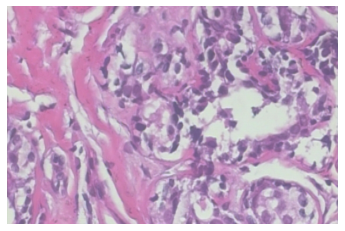

[[0.8678131]] -> Malignantです。


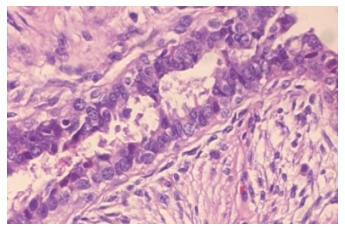

[[0.13242885]] -> Benignです。


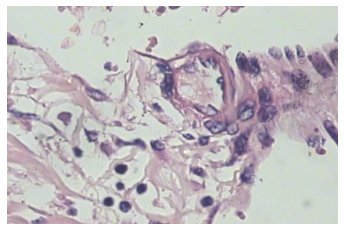

[[0.12682839]] -> Benignです。


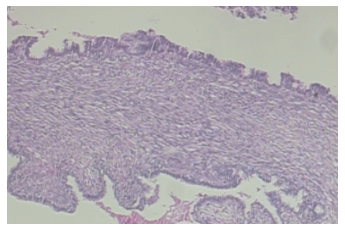

[[0.00034333]] -> Benignです。


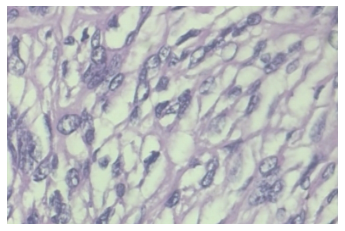

[[3.1065113e-09]] -> Benignです。


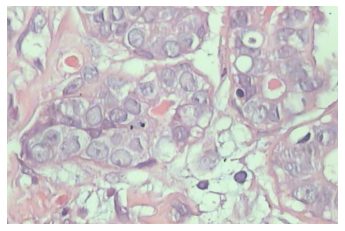

[[0.91531247]] -> Malignantです。


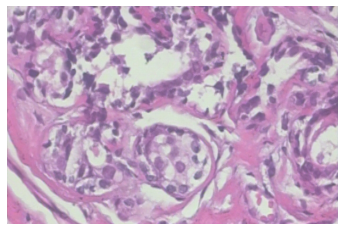

[[0.01573874]] -> Benignです。


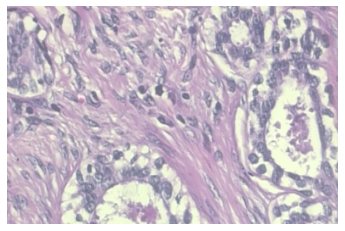

[[0.09930992]] -> Benignです。


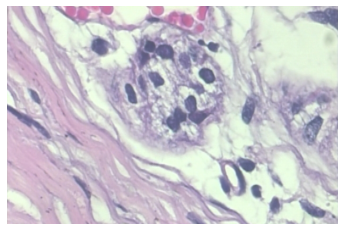

[[1.7226344e-06]] -> Benignです。


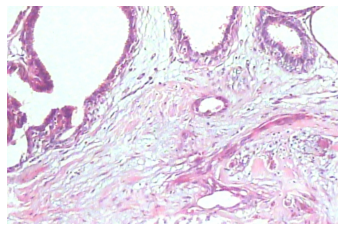

[[4.3450687e-05]] -> Benignです。


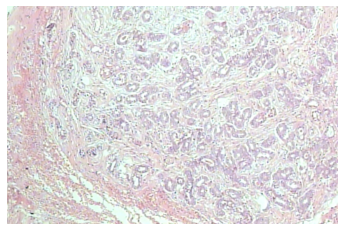

[[0.84383166]] -> Malignantです。


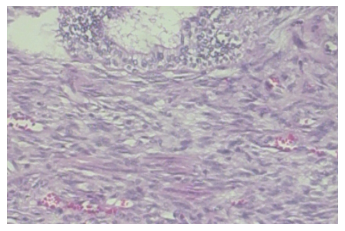

[[0.00482378]] -> Benignです。


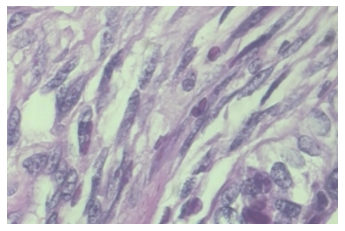

[[1.5441863e-06]] -> Benignです。


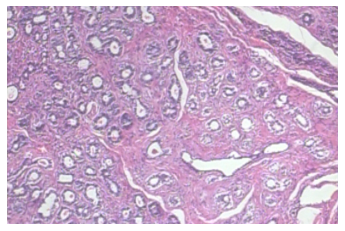

[[0.00546237]] -> Benignです。


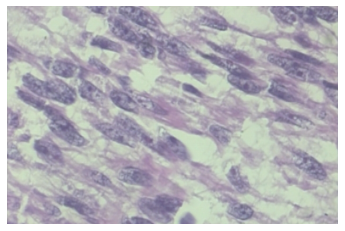

[[0.9993542]] -> Malignantです。


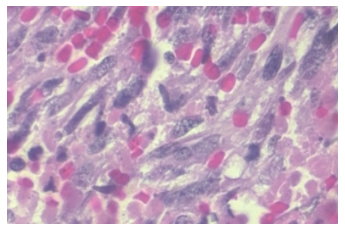

[[0.00318288]] -> Benignです。


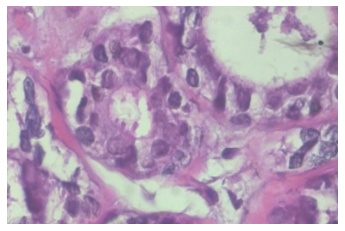

[[0.99997663]] -> Malignantです。


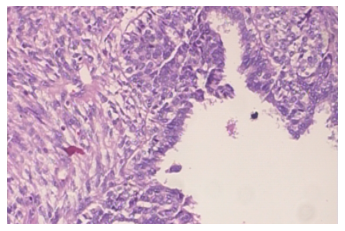

[[0.87834185]] -> Malignantです。


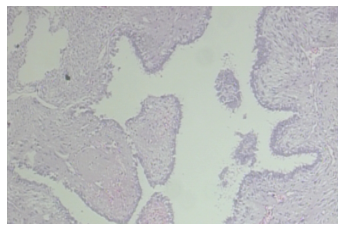

[[3.0148512e-06]] -> Benignです。


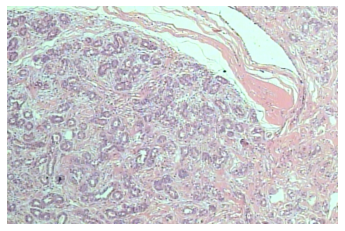

[[0.40129477]] -> Benignです。


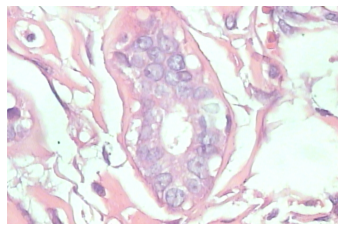

[[1.474807e-06]] -> Benignです。


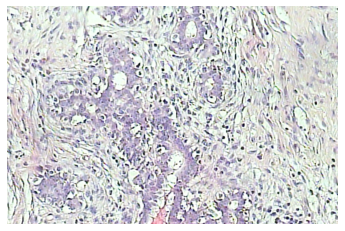

[[0.41421837]] -> Benignです。


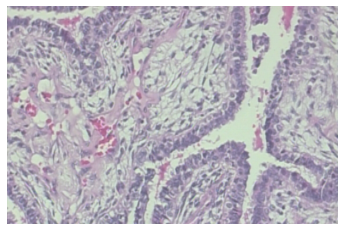

[[0.00049627]] -> Benignです。


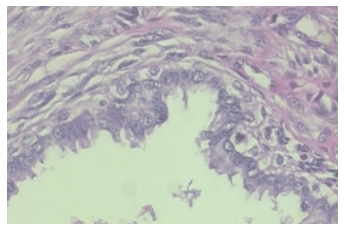

[[0.44435334]] -> Benignです。


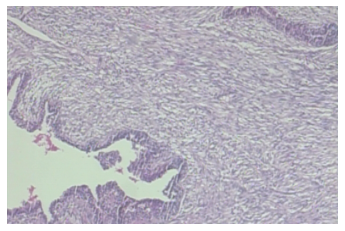

[[0.14170524]] -> Benignです。


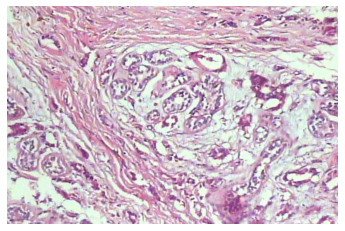

[[0.99939215]] -> Malignantです。


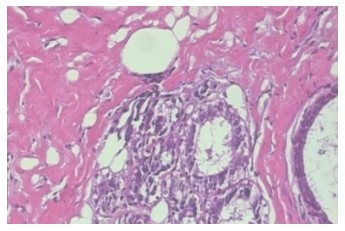

[[1.5504961e-06]] -> Benignです。


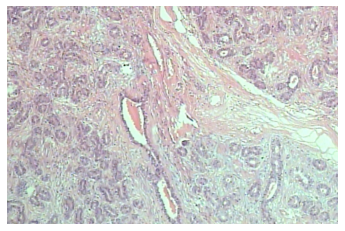

[[2.2420494e-11]] -> Benignです。


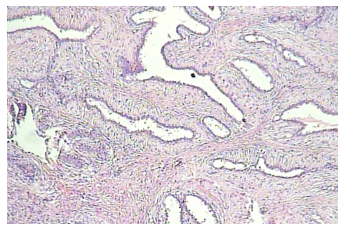

[[1.3412553e-11]] -> Benignです。


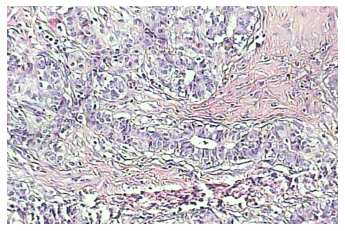

[[0.9982066]] -> Malignantです。


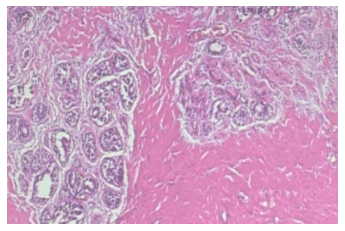

[[0.00435371]] -> Benignです。


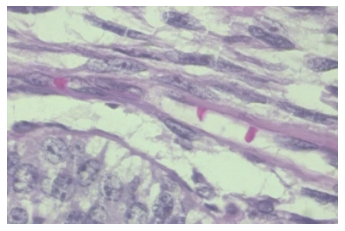

[[0.00422777]] -> Benignです。


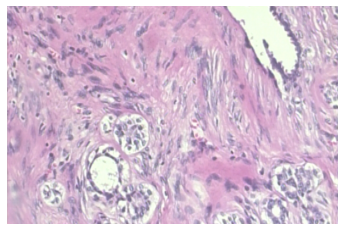

[[0.5978503]] -> Malignantです。


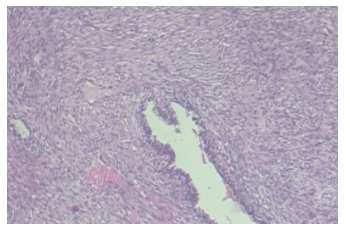

[[0.9988205]] -> Malignantです。


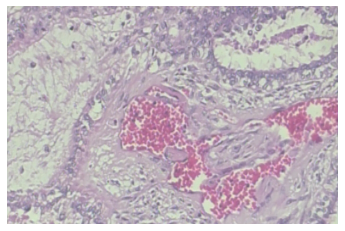

[[0.00038669]] -> Benignです。


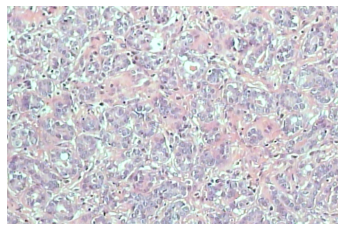

[[0.01898803]] -> Benignです。


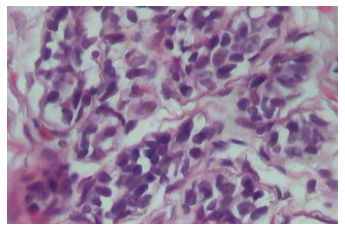

[[0.99995136]] -> Malignantです。


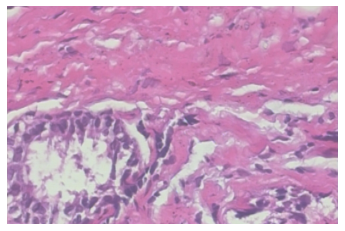

[[0.0106838]] -> Benignです。


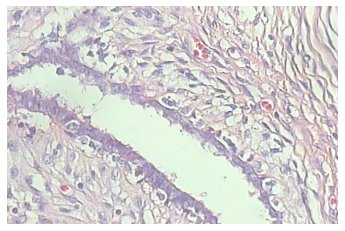

[[0.9998841]] -> Malignantです。


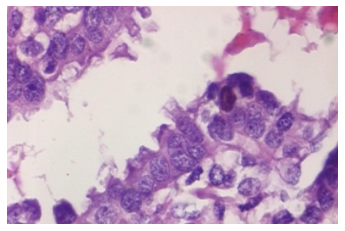

[[0.36834455]] -> Benignです。


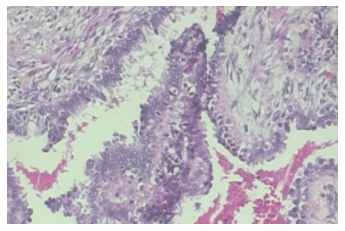

[[2.4212222e-05]] -> Benignです。


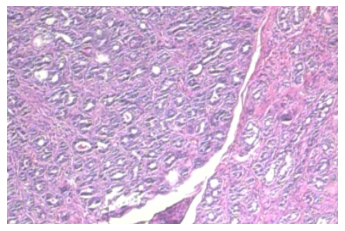

[[0.00920936]] -> Benignです。


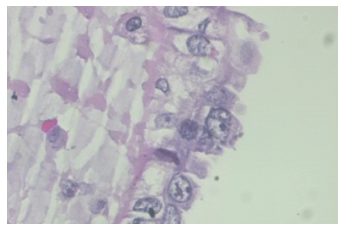

[[0.195667]] -> Benignです。


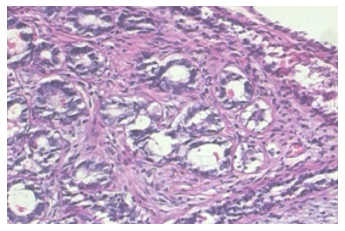

[[0.9912582]] -> Malignantです。


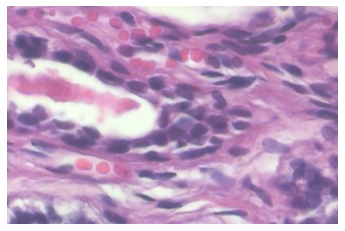

[[0.00036627]] -> Benignです。


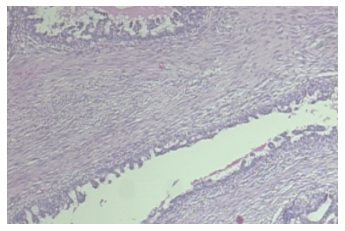

[[0.8710777]] -> Malignantです。


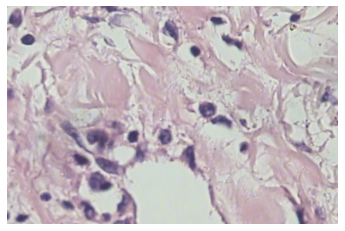

[[0.9999385]] -> Malignantです。


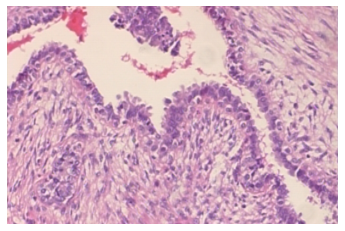

[[7.2389247e-07]] -> Benignです。


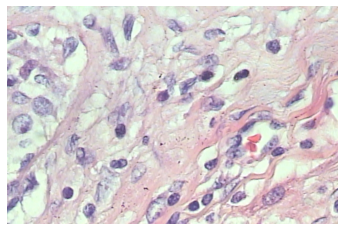

[[0.4180349]] -> Benignです。


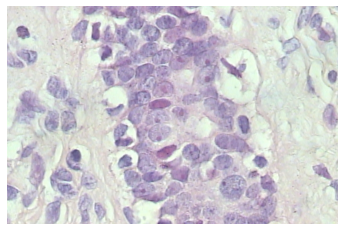

[[0.08024045]] -> Benignです。


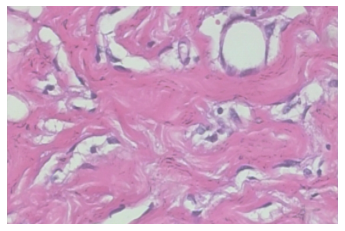

[[0.00259328]] -> Benignです。


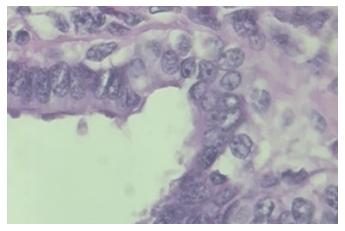

[[0.01809674]] -> Benignです。


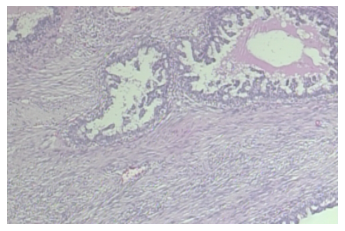

[[0.01583301]] -> Benignです。


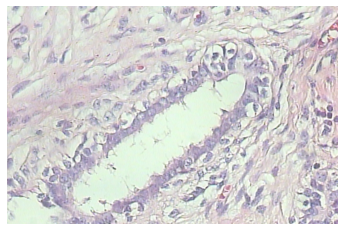

[[0.00113433]] -> Benignです。


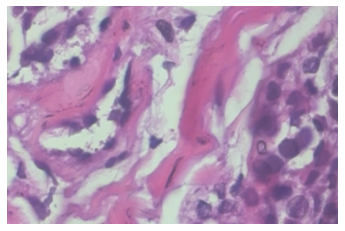

[[0.1486391]] -> Benignです。


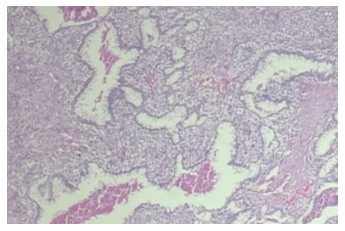

[[0.00058818]] -> Benignです。


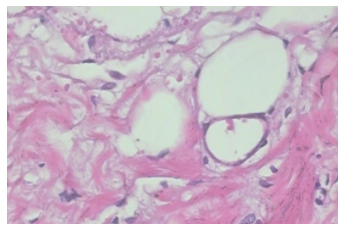

[[0.2733176]] -> Benignです。


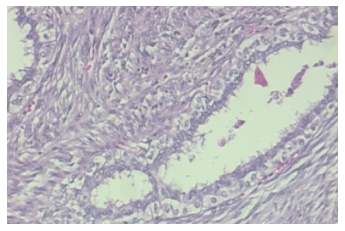

[[2.3761888e-06]] -> Benignです。


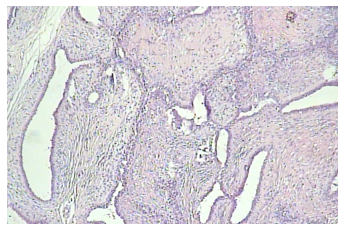

[[1.]] -> Malignantです。


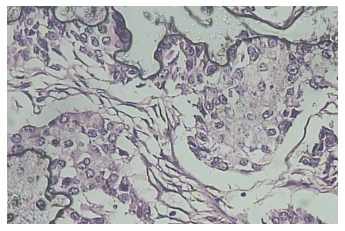

[[0.83848476]] -> Malignantです。


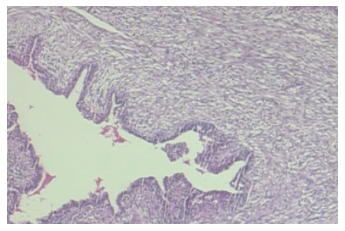

[[0.9992805]] -> Malignantです。


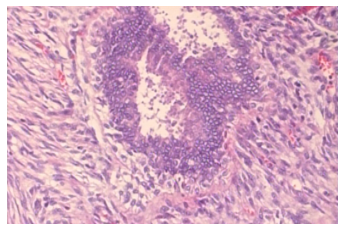

[[0.04756774]] -> Benignです。


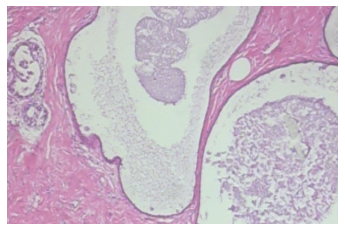

[[0.04104145]] -> Benignです。


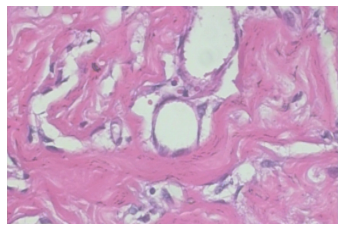

[[0.0002034]] -> Benignです。


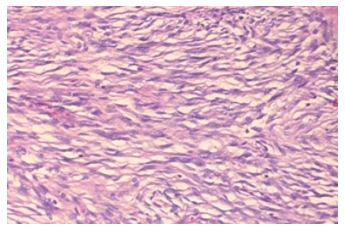

[[0.99247414]] -> Malignantです。


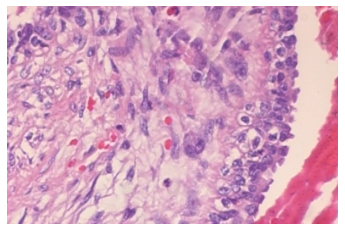

[[0.00209293]] -> Benignです。


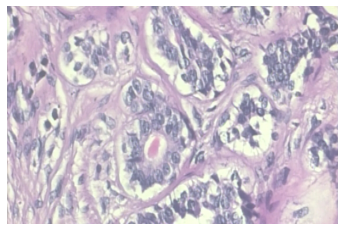

[[1.839601e-11]] -> Benignです。


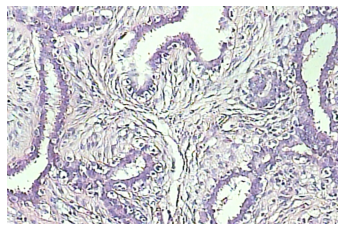

[[0.03233229]] -> Benignです。


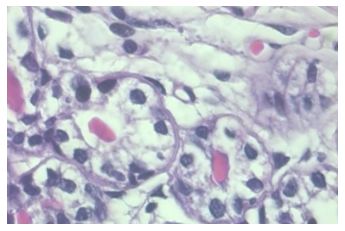

[[0.9999999]] -> Malignantです。


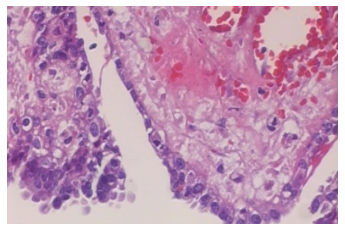

[[0.01975316]] -> Benignです。


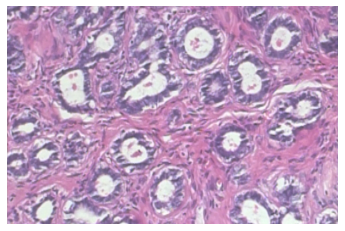

[[2.3758542e-10]] -> Benignです。


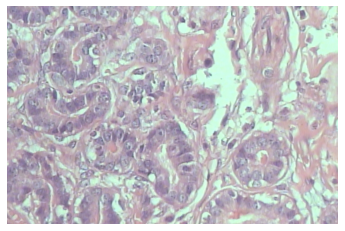

[[0.83803326]] -> Malignantです。


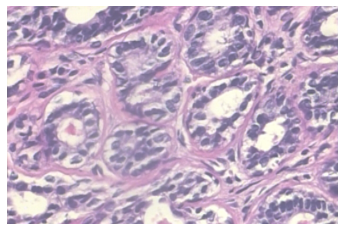

[[0.00109571]] -> Benignです。


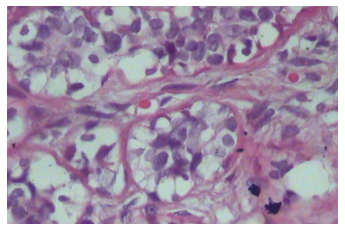

[[0.14045434]] -> Benignです。


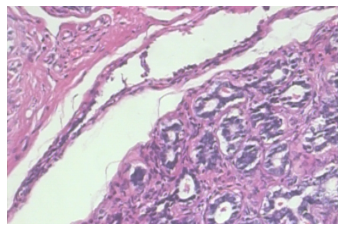

[[0.00545353]] -> Benignです。


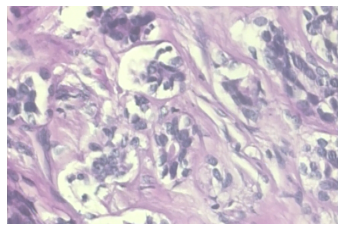

[[2.476387e-05]] -> Benignです。


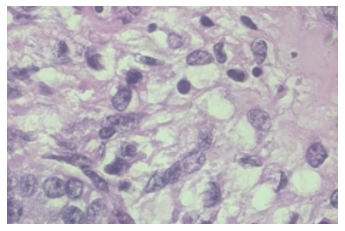

[[0.00812637]] -> Benignです。


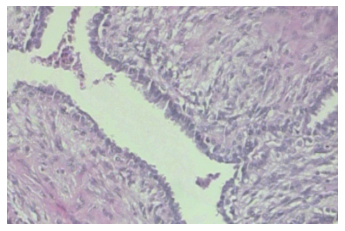

In [ ]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

train_data_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data/train' # 訓練データのフォルダー
validation_data_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data/validation' # テストデータのフォルダー
result_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/results'        # VGG16の出力結果を保存するフォルダー
test_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/test'
    

normal_files=os.listdir(os.path.join(test_dir,'benign'))
print(len(normal_files))
print(normal_files)

%matplotlib inline


for i in range(len(normal_files)):
  predictBreakHisVGG16(os.path.join(test_dir,'benign',normal_files[i]))




### ７８枚の画像データの真値は、Benignであるが、それをVGG16モデルで予測したところ、２２枚を間違って、malignantと判定した。正答率は、７１．８％であった。

### 乳癌患者由来の画像に対して、先ほど構築したモデルで予測する。
『malignantです。』と表示されていれば、正解。

94
['SOB_M_LC-14-13412-400-024.png', 'SOB_M_DC-14-2980-400-009.png', 'SOB_M_DC-14-2523-100-033.png', 'SOB_M_LC-14-13412-200-011.png', 'SOB_M_DC-14-18650-400-025.png', 'SOB_M_DC-14-6241-200-012.png', 'SOB_M_DC-14-17614-100-004.png', 'SOB_M_DC-14-18650-400-012.png', 'SOB_M_LC-14-15570-200-039.png', 'SOB_M_DC-14-3909-400-002.png', 'SOB_M_DC-14-11951-40-020.png', 'SOB_M_DC-14-2980-200-016.png', 'SOB_M_DC-14-18650-400-016.png', 'SOB_M_DC-14-3909-200-007.png', 'SOB_M_MC-14-13413-400-005.png', 'SOB_M_LC-14-15570-100-025.png', 'SOB_M_DC-14-17915-100-009.png', 'SOB_M_PC-14-15704-100-014.png', 'SOB_M_DC-14-17614-40-038.png', 'SOB_M_PC-14-15687B-400-014.png', 'SOB_M_PC-14-15704-400-015.png', 'SOB_M_DC-14-17915-40-016.png', 'SOB_M_DC-14-11520-100-021.png', 'SOB_M_DC-14-17915-400-013.png', 'SOB_M_MC-14-13413-400-015.png', 'SOB_M_DC-14-17915-200-019.png', 'SOB_M_DC-14-16716-100-024.png', 'SOB_M_DC-14-11520-200-007.png', 'SOB_M_LC-14-15570-40-027.png', 'SOB_M_PC-14-15704-200-022.png', 'SOB_M_MC-14-13

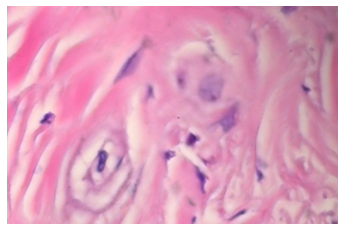

[[0.99794096]] -> Malignantです。


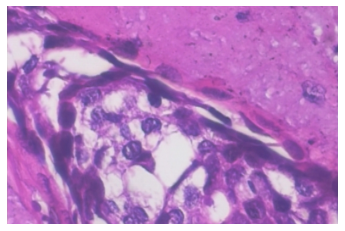

[[1.]] -> Malignantです。


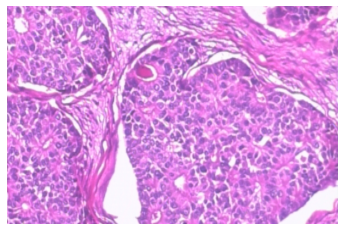

[[0.9892876]] -> Malignantです。


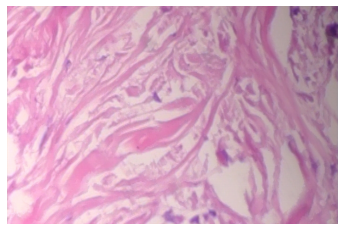

[[0.9999888]] -> Malignantです。


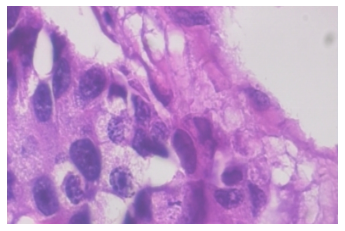

[[0.9996215]] -> Malignantです。


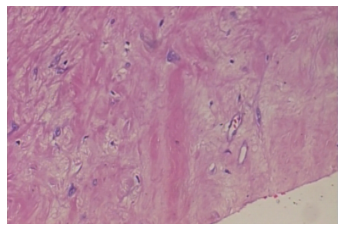

[[0.99999416]] -> Malignantです。


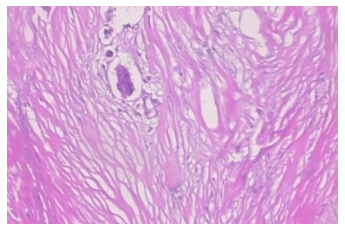

[[0.99963427]] -> Malignantです。


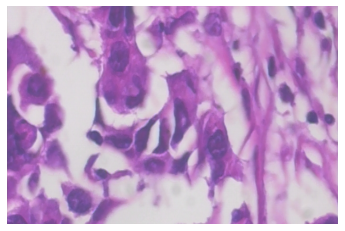

[[0.9999968]] -> Malignantです。


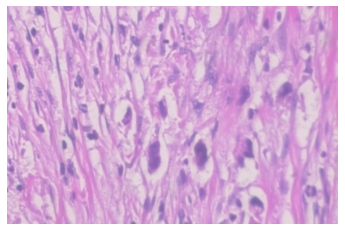

[[0.99908674]] -> Malignantです。


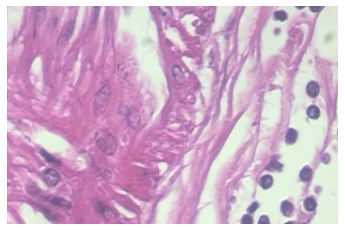

[[1.]] -> Malignantです。


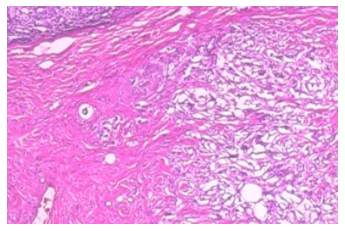

[[0.99999976]] -> Malignantです。


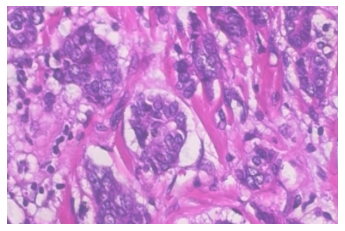

[[0.999461]] -> Malignantです。


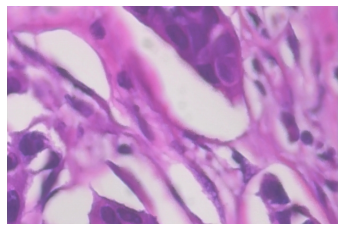

[[0.99981505]] -> Malignantです。


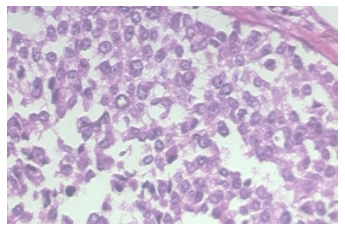

[[0.9928993]] -> Malignantです。


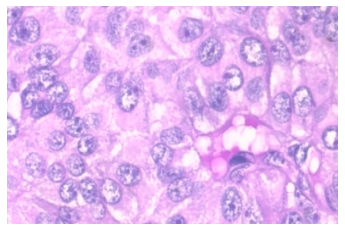

[[0.97527564]] -> Malignantです。


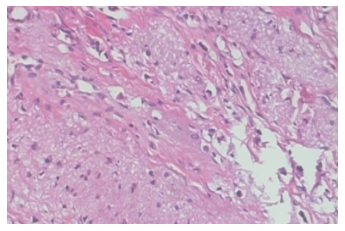

[[0.9999988]] -> Malignantです。


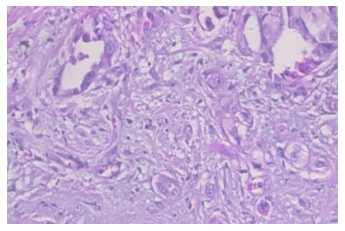

[[0.999884]] -> Malignantです。


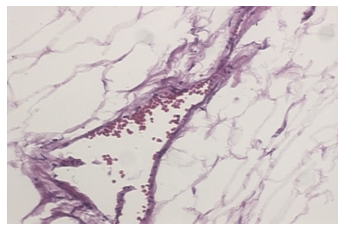

[[0.9999999]] -> Malignantです。


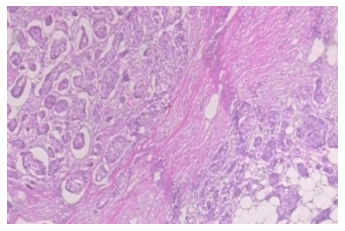

[[0.02669242]] -> Benignです。


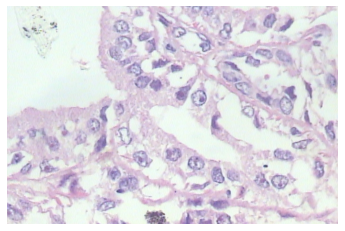

[[0.85781133]] -> Malignantです。


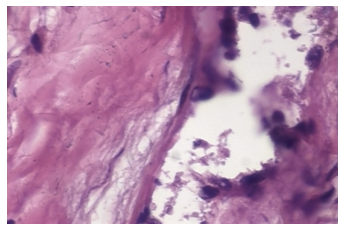

[[0.9999999]] -> Malignantです。


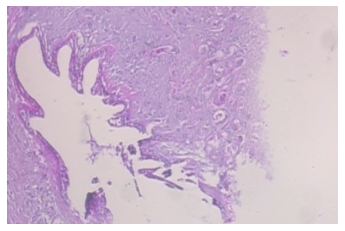

[[0.9999999]] -> Malignantです。


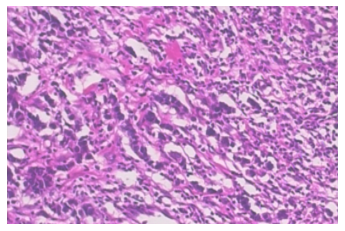

[[0.9999999]] -> Malignantです。


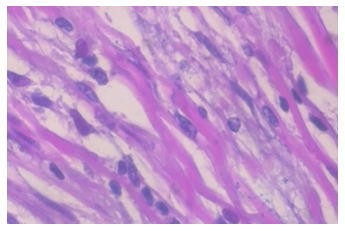

[[0.93516326]] -> Malignantです。


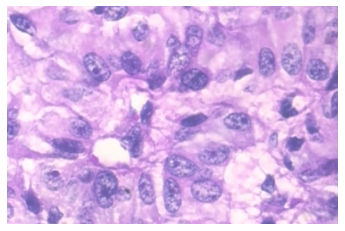

[[0.99999964]] -> Malignantです。


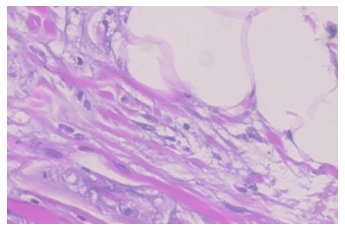

[[1.]] -> Malignantです。


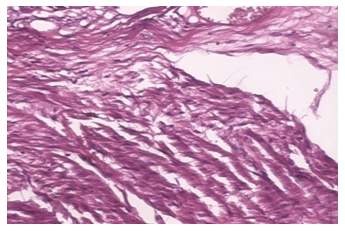

[[0.99952483]] -> Malignantです。


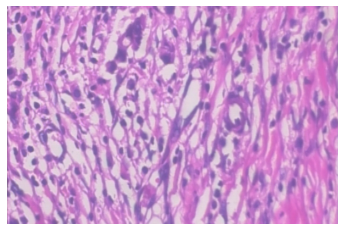

[[0.99996126]] -> Malignantです。


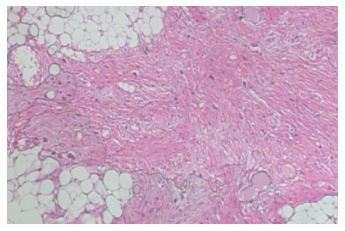

[[1.]] -> Malignantです。


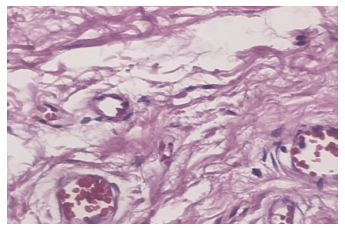

[[0.9999964]] -> Malignantです。


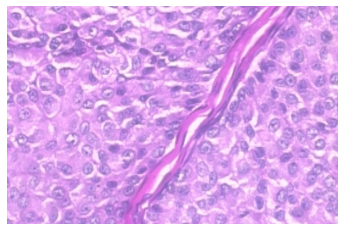

[[1.]] -> Malignantです。


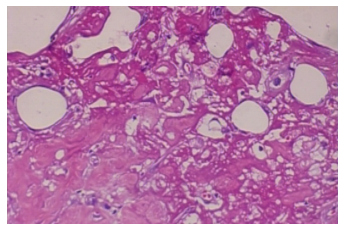

[[0.9997017]] -> Malignantです。


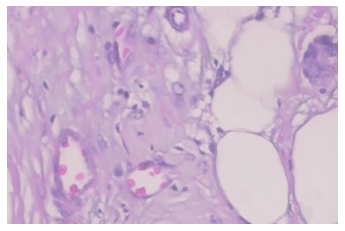

[[0.9982079]] -> Malignantです。


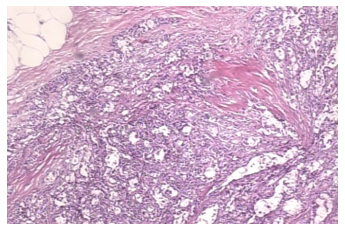

[[0.8856681]] -> Malignantです。


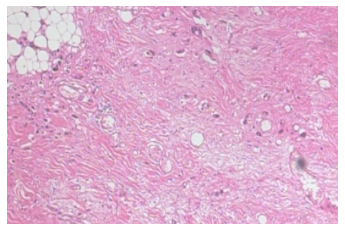

[[1.]] -> Malignantです。


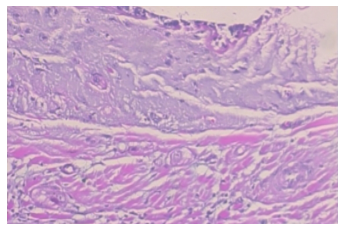

[[0.99983644]] -> Malignantです。


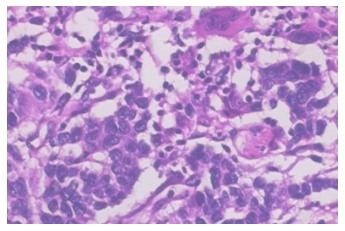

[[0.99999905]] -> Malignantです。


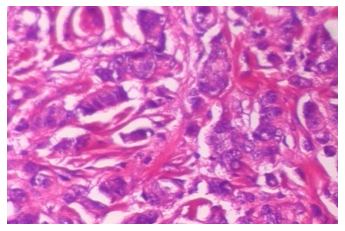

[[1.]] -> Malignantです。


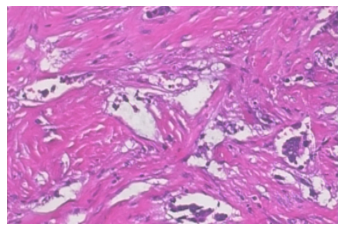

[[0.99956423]] -> Malignantです。


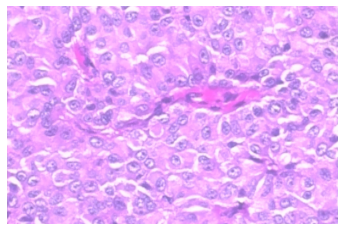

[[0.97090495]] -> Malignantです。


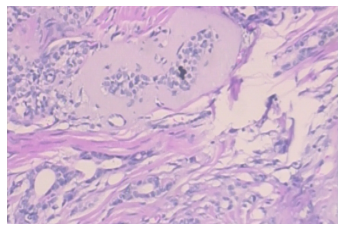

[[1.]] -> Malignantです。


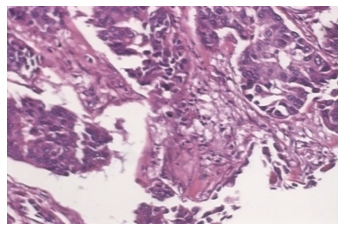

[[0.21932222]] -> Benignです。


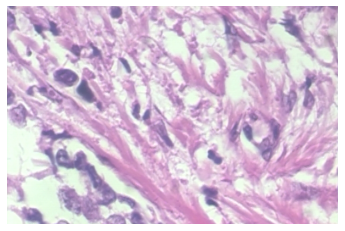

[[1.]] -> Malignantです。


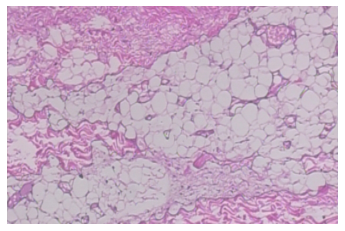

[[0.9996124]] -> Malignantです。


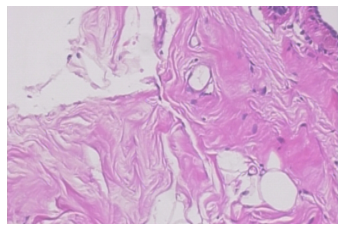

[[0.99763703]] -> Malignantです。


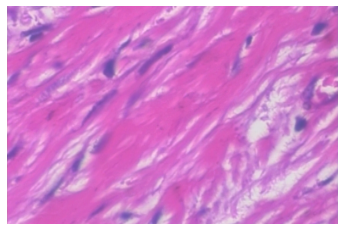

[[0.9999591]] -> Malignantです。


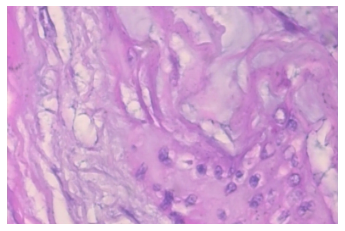

[[0.999987]] -> Malignantです。


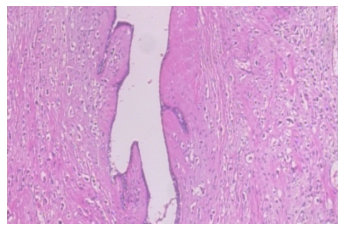

[[1.]] -> Malignantです。


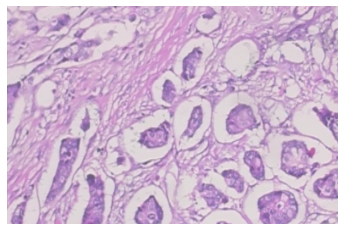

[[0.9999944]] -> Malignantです。


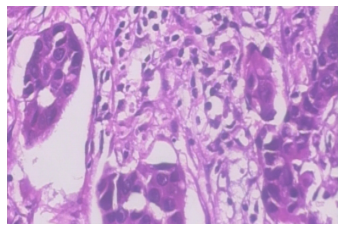

[[1.]] -> Malignantです。


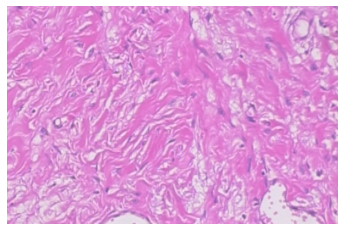

[[0.91835016]] -> Malignantです。


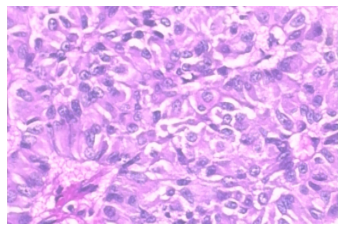

[[0.99882835]] -> Malignantです。


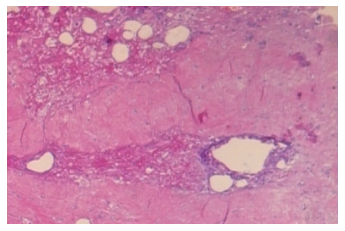

[[0.9997106]] -> Malignantです。


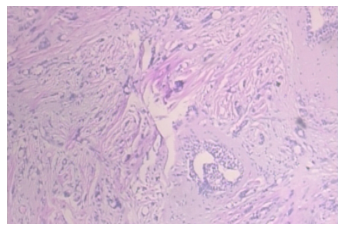

[[0.7976366]] -> Malignantです。


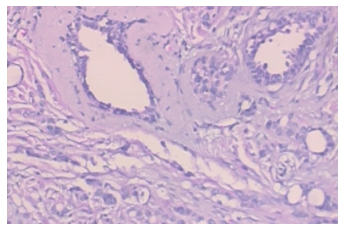

[[1.]] -> Malignantです。


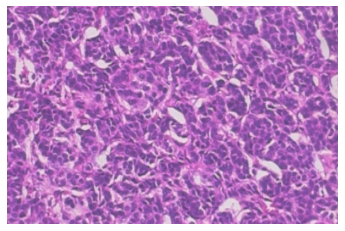

[[0.42962727]] -> Benignです。


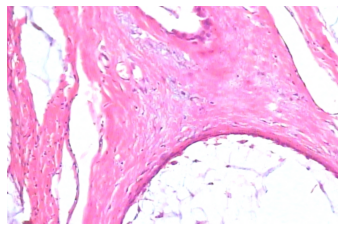

[[1.]] -> Malignantです。


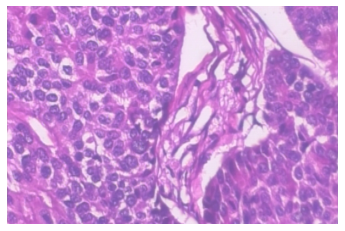

[[0.9998468]] -> Malignantです。


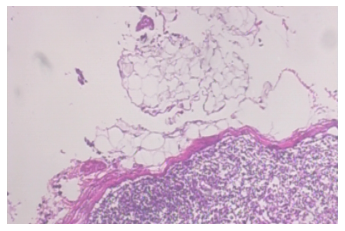

[[0.99994993]] -> Malignantです。


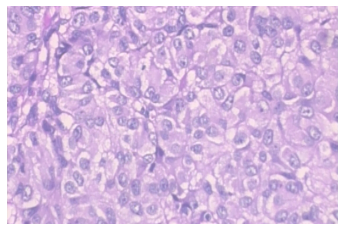

[[0.99995494]] -> Malignantです。


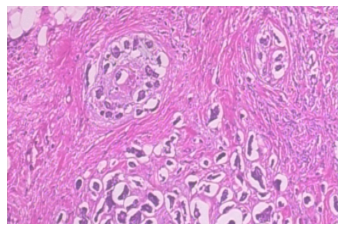

[[0.9969387]] -> Malignantです。


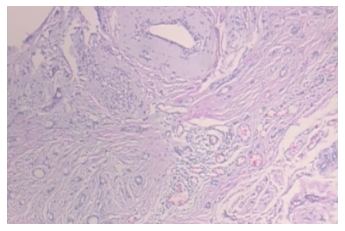

[[0.9641494]] -> Malignantです。


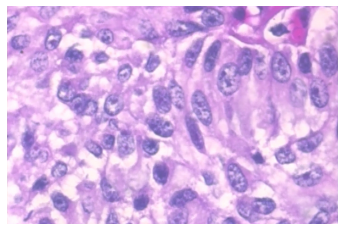

[[0.9999145]] -> Malignantです。


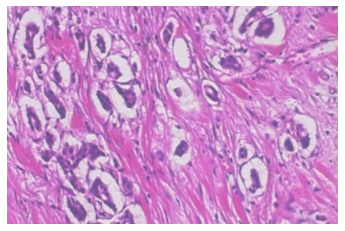

[[0.02714601]] -> Benignです。


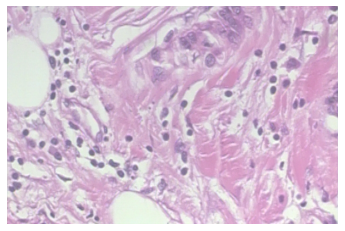

[[0.99979097]] -> Malignantです。


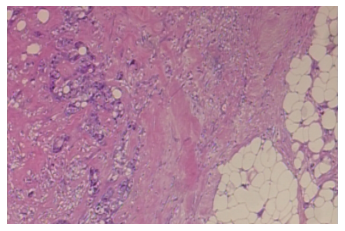

[[0.99928916]] -> Malignantです。


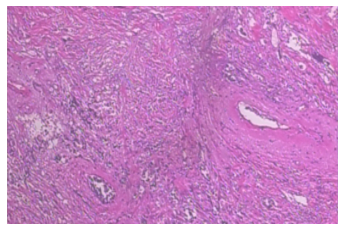

[[0.9999981]] -> Malignantです。


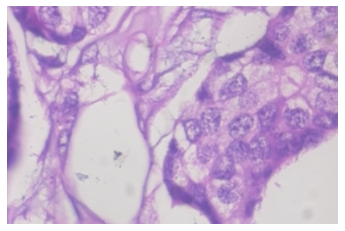

[[0.9994943]] -> Malignantです。


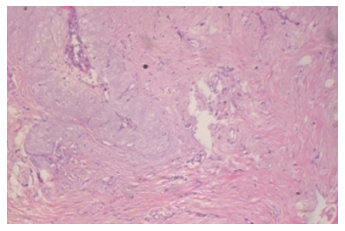

[[0.7147479]] -> Malignantです。


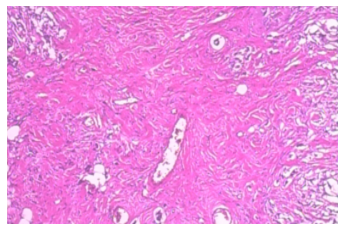

[[1.]] -> Malignantです。


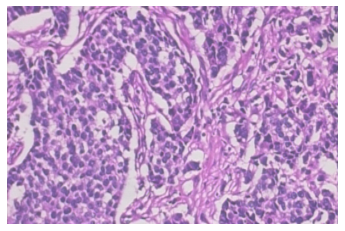

[[0.87051785]] -> Malignantです。


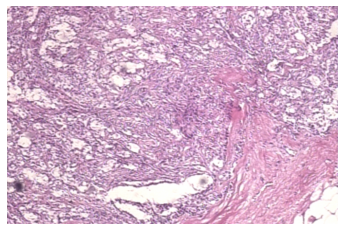

[[0.9997383]] -> Malignantです。


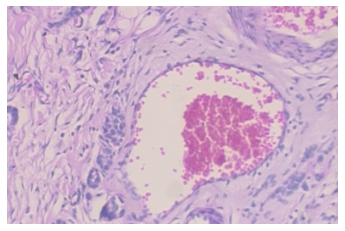

[[0.9996275]] -> Malignantです。


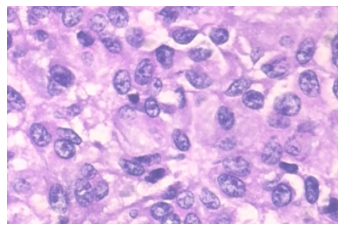

[[0.99982435]] -> Malignantです。


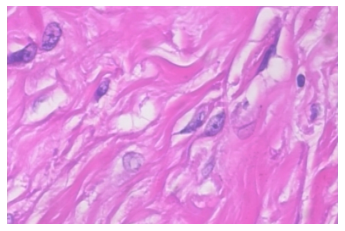

[[1.]] -> Malignantです。


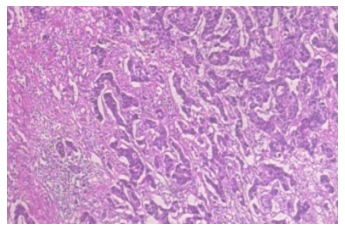

[[0.99999976]] -> Malignantです。


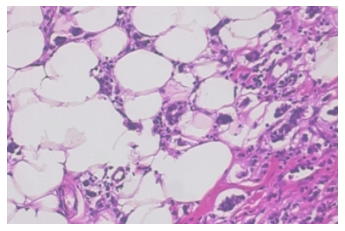

[[1.]] -> Malignantです。


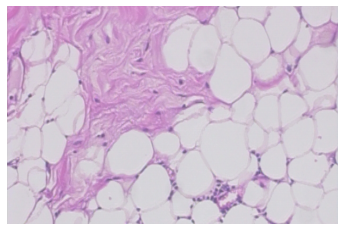

[[0.99545276]] -> Malignantです。


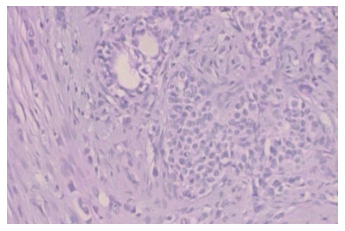

[[0.9999993]] -> Malignantです。


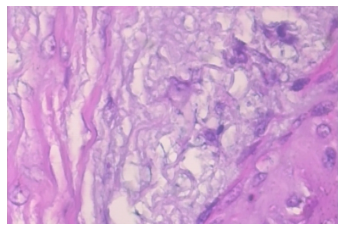

[[1.]] -> Malignantです。


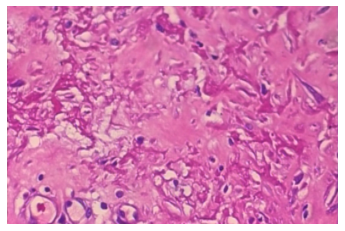

[[0.01057709]] -> Benignです。


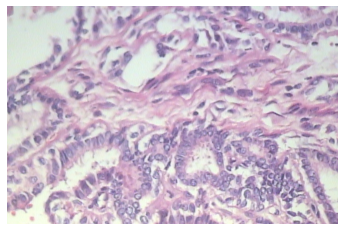

[[0.99991965]] -> Malignantです。


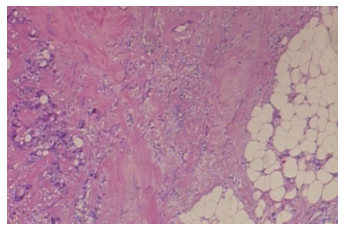

[[0.99999976]] -> Malignantです。


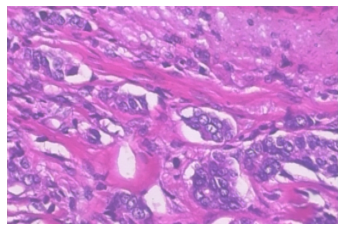

[[0.9999635]] -> Malignantです。


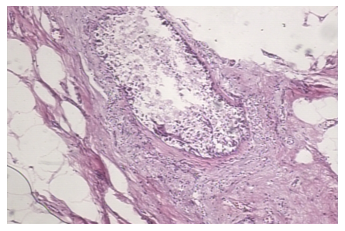

[[1.]] -> Malignantです。


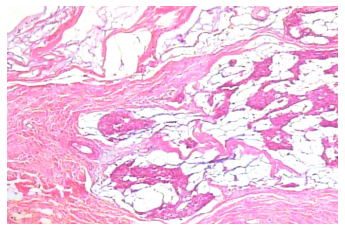

[[0.9991572]] -> Malignantです。


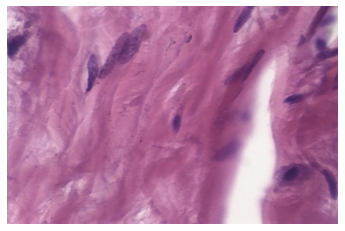

[[0.999998]] -> Malignantです。


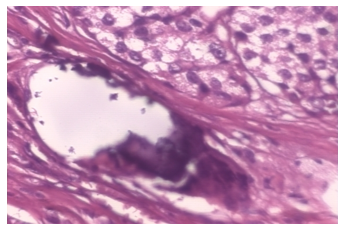

[[1.]] -> Malignantです。


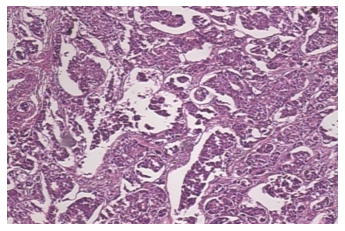

[[0.999985]] -> Malignantです。


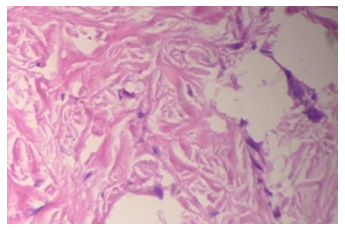

[[0.99975663]] -> Malignantです。


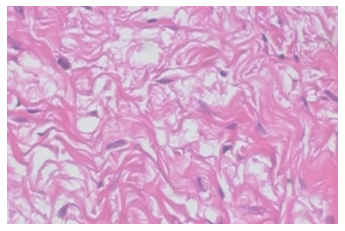

[[0.9996125]] -> Malignantです。


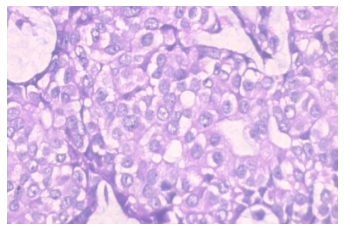

[[0.9999999]] -> Malignantです。


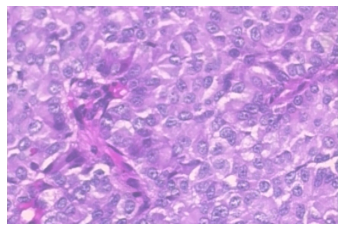

[[0.9899171]] -> Malignantです。


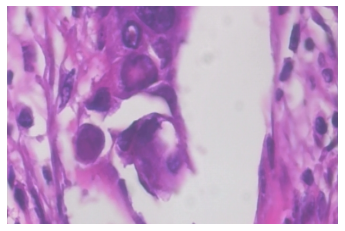

In [ ]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

train_data_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data/train' # 訓練データのフォルダー
validation_data_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/data/validation' # テストデータのフォルダー
result_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/results'        # VGG16の出力結果を保存するフォルダー
test_dir = '/content/gdrive/My Drive/Colab Notebooks/BreakHis/test'
    

malignant_files=os.listdir(os.path.join(test_dir,'malignant'))
print(len(malignant_files))
print(malignant_files)

%matplotlib inline


for i in range(len(malignant_files)):
  predictBreakHisVGG16(os.path.join(test_dir,'malignant',malignant_files[i]))



## 94枚の乳がん患者由来の画像であったが、94枚のうち、5枚を誤って、正常と判定した。正答率は、９４．６８％であった。

#【考察】  

##乳癌患者由来の画像については、９４枚中、８９枚が正解であった。乳がん患者由来の画像についての正答率は、９４．６８％であった。健康成人由来の画像については、７８枚中、５６枚が正解であった。健康成人由来の画像については、正答率は、７１．８％であった。

## 再現率 (recall, 感度, sensitivity)：実際に正であるもののうち，正であると予測されたものの割合

## 特異度 (specificity)：実際に負であるもののうち，負であると予測されたものの割合

## Accuracy: 全体として、正しく予測できるている確率

##Recall: 94.68 %
##Specificity: 71.8 %
## Accuracy : 84.3 %

## 乳癌患者の画像の場合には、かなりの精度で、正解に導いていることが示された。
